In [47]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geodatasets
import geopandas
import plotly.figure_factory as ff
from urllib.request import urlopen
import json
import plotly.graph_objects as go
import plotly.offline as pyo
import datetime 

import copy 

from thefuzz import fuzz, process
# 
plt.style.use('ggplot')


allPlotlyFigs = []

allMatplotlibFigs = []

In [48]:

def read_in_battery_report(filepath):
    sheet_names = {'Co-located with Solar':"solar",
 'Co-located with Wind':"wind",
 'Co-located with Thermal':"thermal",
 'Stand-Alone':"standalone",
#  'Co-located Operational':"operational",
 }
    
    
    sheet_list = []

    for sheet in sheet_names.keys():
        tempSheetRead = pd.read_excel(filepath,sheet_name=sheet,skiprows=13,header=1)
        tempSheetRead.rename(columns={'Unnamed: 12':'Financial Security and Notice to Proceed Provided'},inplace=True)
        tempSheetRead = tempSheetRead.drop(index=range(0, 5))
        tempSheetRead = tempSheetRead.assign(colocated=sheet_names[sheet])
        tempSheetRead['Projected COD'] = pd.to_datetime(tempSheetRead['Projected COD'])
        sheet_list.append(tempSheetRead)
    
    temp = pd.concat(sheet_list)

    
    operationaldf = pd.read_excel(filepath,sheet_name='Co-located Operational',header=13)

    operationaldf.dropna(inplace=True,how='all')
    operationaldf['Capacity (MW)*'].replace(0,np.nan,inplace=True)
    operationaldf['In Service'] = pd.to_datetime(operationaldf['In Service'],format='%Y')
    # operationaldf['In Service'] = operationaldf['In Service'].dt.year
    operationaldf = operationaldf.iloc[:-1]
    return temp, operationaldf.reset_index(drop=True)


filename = './GIS reports and battery identification reports/RPT.00015933.0000000000000000.20240710.132238885.Co-located_Battery_Identification_Report_June_2024 (1).xlsx'
planned, operational = read_in_battery_report(filename)

operational_cumsum = operational.groupby(by=['In Service','Fuel'])['Capacity (MW)*'].sum().unstack().fillna(0).cumsum(axis=0).resample('Y').ffill().reset_index()

/var/folders/8x/g1kk8qss2sz45km8bcf3fggw0000gn/T/ipykernel_10641/4034361518.py:20: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.

/var/folders/8x/g1kk8qss2sz45km8bcf3fggw0000gn/T/ipykernel_10641/4034361518.py:20: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



In [49]:

# first_year = operational_cumsum['In Service'].min().year
# last_year = operational_cumsum['In Service'].max().year


# years_range = pd.date_range(start=str(first_year), end=str(last_year), freq='YS')


# operational_cumsuma = operational_cumsum.set_index('In Service').resample(range(first_year,last_year+1))

# operational_cumsuma

In [50]:
# tempNames = planned['Project Name'].sort_values().to_list()

In [51]:
# operational_cumsum

In [52]:

# def get_unique_names(names, threshold=90):
#     unique_names = {}
#     for name in names:
#         if not unique_names.keys():
#             unique_names[name] = name
#         else:
#             match_found = False
#             for unique_name in unique_names.keys():
#                 if fuzz.ratio(name, unique_name) > threshold:
#                     match_found = True
#                     unique_names[unique_name] = name
#                     break
#             if not match_found:
#                 unique_names[name] = name
    
#     return unique_names

# # Example usage

# unique_names = get_unique_names(tempNames)


In [53]:
# unique_names

In [54]:
# tempNames

In [55]:
# planned.to_excel('./outputExcels/planned_batteries.xlsx')

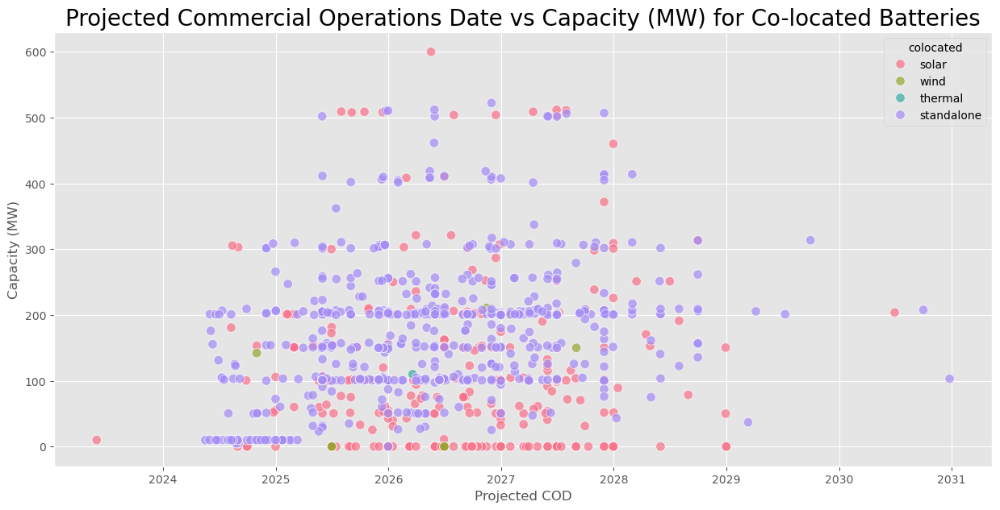

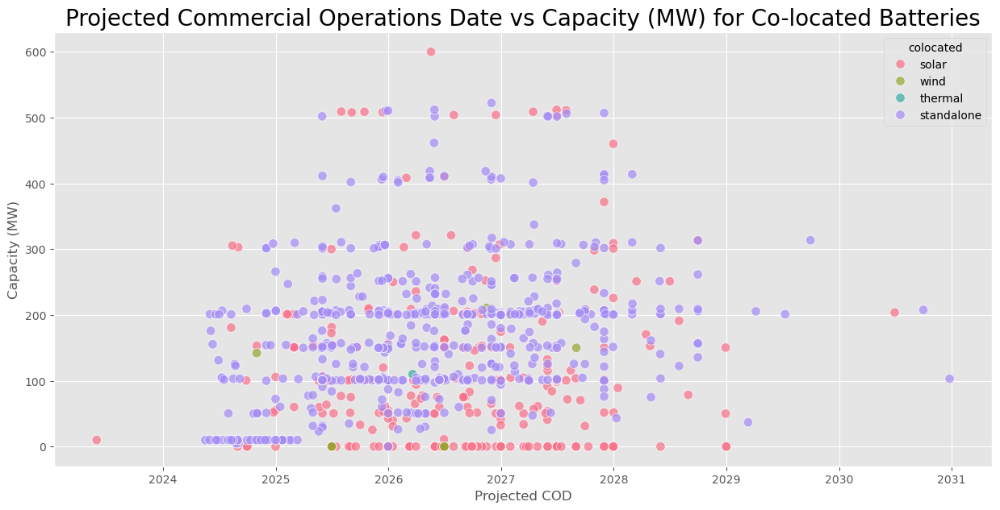

In [137]:
def plot_dates_against_capacity(kf):
    plt.figure(figsize=(15,7))
    sns.scatterplot(data=kf.loc[planned['Fuel']=='OTH'], x='Projected COD',y='Capacity (MW)',s=70,hue='colocated',alpha=0.7,palette=sns.color_palette("husl", 4))
    plt.title('Projected Commercial Operations Date vs Capacity (MW) for Co-located Batteries',fontsize=20)

    allMatplotlibFigs.append(copy.deepcopy(plt.gcf()))

plot_dates_against_capacity(planned)



In [138]:

def plot_by_finance(kf,tohtml=False):
    fig = px.scatter(data_frame=kf.loc[kf['Fuel']=='OTH'], x='Projected COD',y='Capacity (MW)',color='Financial Security and Notice to Proceed Provided',custom_data=['Project Name','Financial Security and Notice to Proceed Provided','Interconnecting Entity'])
    fig.update_layout(title='Projected Commercial Operations Date vs Capacity (MW) for Co-located Batteries',legend_title='Finance and Notice Provided',xaxis_title='Projected Commercial Operations Date',yaxis_title='Capacity (MW)')
    fig.update_traces(
        hovertemplate="<br>".join([
            "Project Name: %{customdata[0]}",
            "Interconnecting Entity: %{customdata[2]}",
            "Projected Commerical Operations Date: %{x}",
            "Capacity (MW): %{y}",
            "Financial Security and<br> Notice to Proceed Provided: %{customdata[1]}",
        ]),marker=dict(size=10),opacity=0.7)


    allMatplotlibFigs.append(copy.deepcopy(plt.gcf()))

    if tohtml:
        fig.write_html('battery_report.html')
        return
    fig.show()




plot_by_finance(planned)




/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [58]:
fig = px.area(operational_cumsum,
              x='In Service',
              y=['GAS','OTH','SOL','WIN'],
              labels={'value':'Capacity (MW)','variable':'Fuel Type'},
              title='Total operational Capacity (MW) over Time by Fuel Type')



fig.update_layout(
    xaxis=dict(rangeslider=dict(visible=True),dtick="M12"),
    title='Total operational Capacity (MW) over Time by Fuel Type',
    hovermode='x unified',
)
allPlotlyFigs.append(copy.deepcopy(fig))
fig.show()



/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



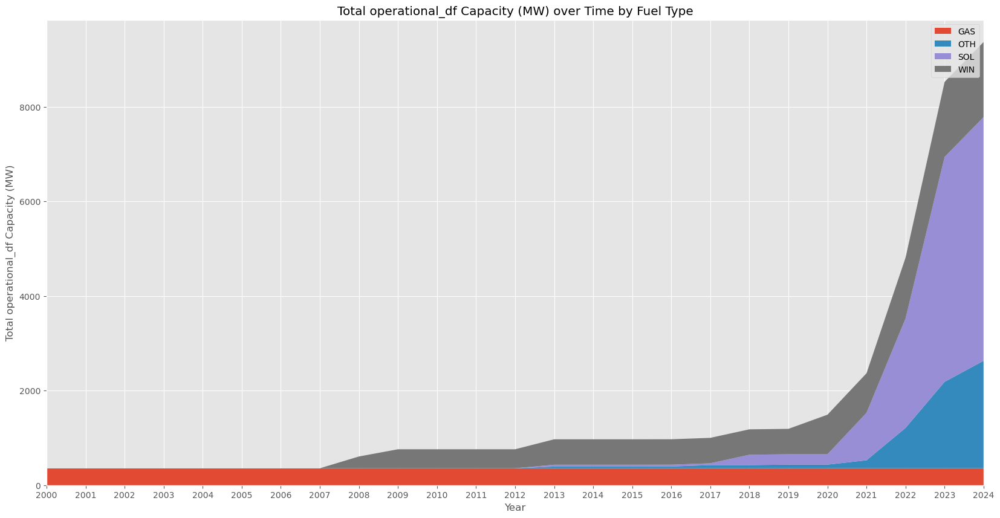

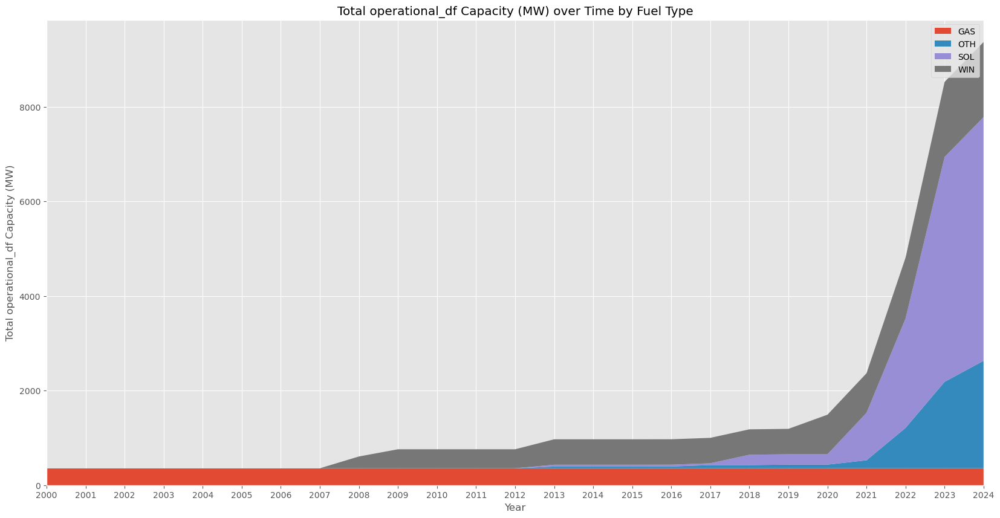

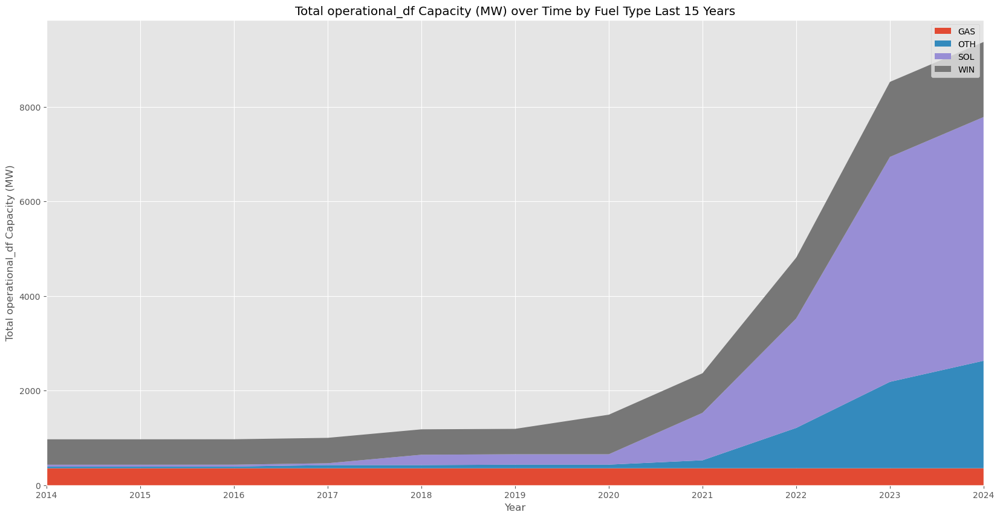

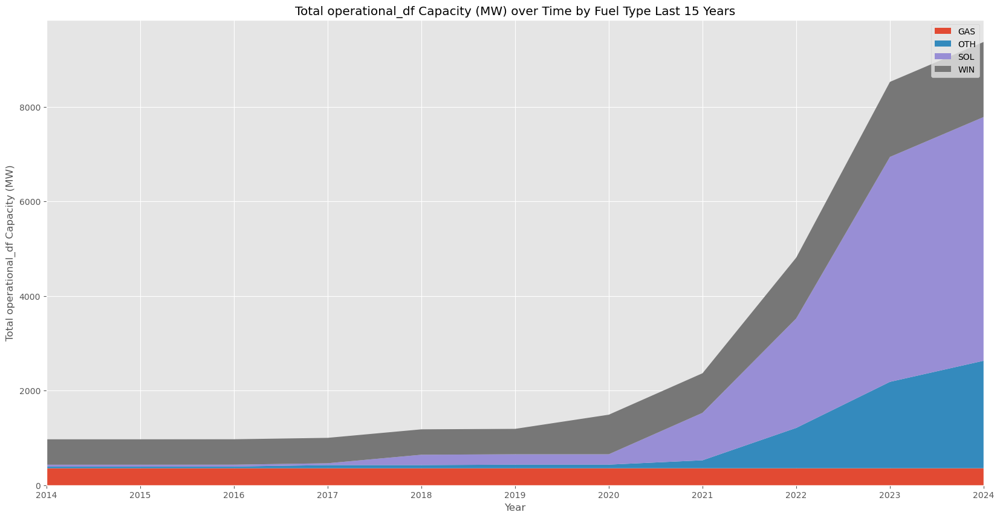

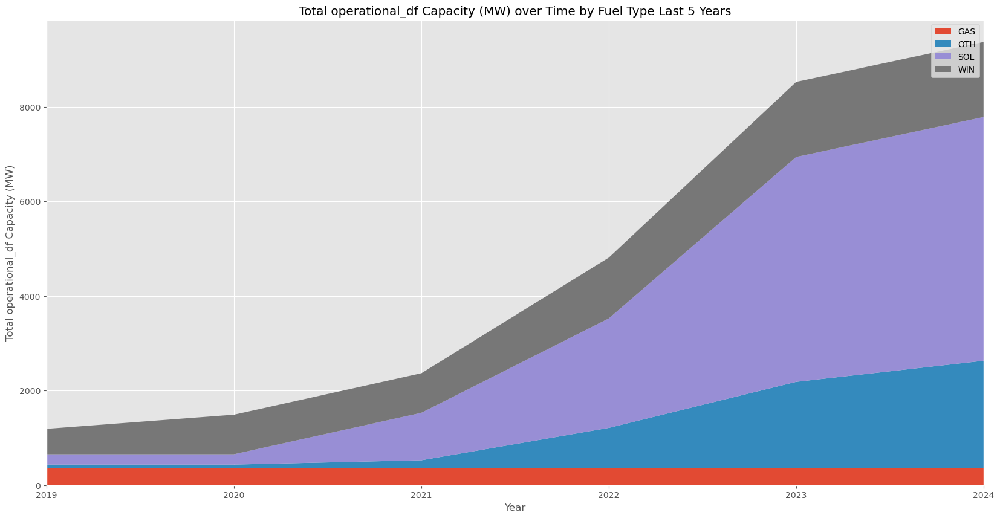

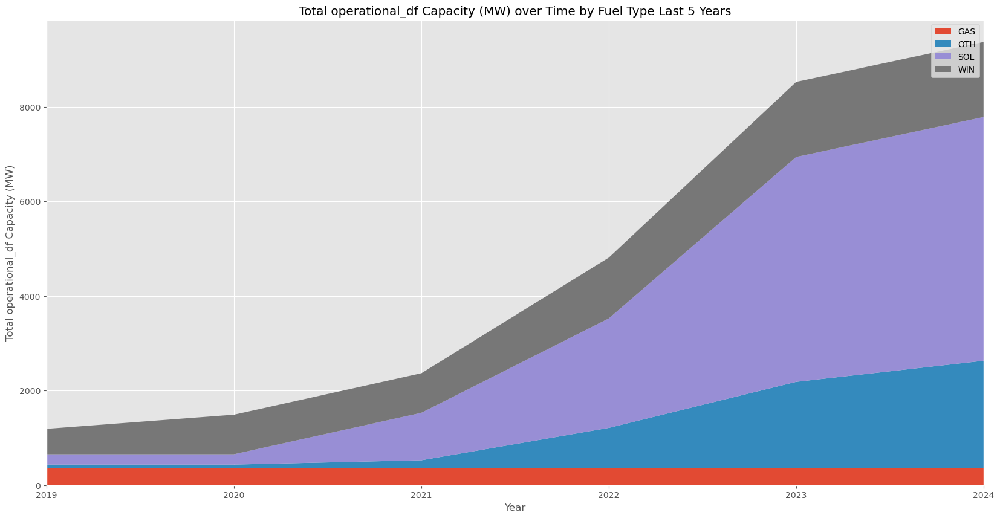

In [139]:
fig = plt.figure(figsize=(20,10))


# def update_plot_a(year):
plt.stackplot(operational_cumsum['In Service'].dt.year, operational_cumsum['GAS'],operational_cumsum['OTH'],operational_cumsum['SOL'],operational_cumsum['WIN'],labels=['GAS','OTH','SOL','WIN'])
plt.legend()
plt.xlabel('Year')
plt.ylabel('Total operational_df Capacity (MW)')
plt.title('Total operational_df Capacity (MW) over Time by Fuel Type')
plt.xticks(range(2000,2025))
plt.xlim(2000,2024)
allMatplotlibFigs.append(copy.deepcopy(plt.gcf()))

plt.show()

plt.figure(figsize=(20,10))
plt.stackplot(operational_cumsum['In Service'].dt.year, operational_cumsum['GAS'],operational_cumsum['OTH'],operational_cumsum['SOL'],operational_cumsum['WIN'],labels=['GAS','OTH','SOL','WIN'])
plt.legend()
plt.xlabel('Year')
plt.ylabel('Total operational_df Capacity (MW)')
plt.title('Total operational_df Capacity (MW) over Time by Fuel Type Last 15 Years')
plt.xticks(range(2000,2025))
plt.xlim(2014,2024)
allMatplotlibFigs.append(copy.deepcopy(plt.gcf()))
plt.show()

plt.figure(figsize=(20,10))
plt.stackplot(operational_cumsum['In Service'].dt.year, operational_cumsum['GAS'],operational_cumsum['OTH'],operational_cumsum['SOL'],operational_cumsum['WIN'],labels=['GAS','OTH','SOL','WIN'])
plt.legend()
plt.xlabel('Year')
plt.ylabel('Total operational_df Capacity (MW)')
plt.title('Total operational_df Capacity (MW) over Time by Fuel Type Last 5 Years')
plt.xticks(range(2000,2025))
plt.xlim(2019,2024)
allMatplotlibFigs.append(copy.deepcopy(plt.gcf()))
plt.show()


In [60]:
# operational_cumsum

In [61]:
# 

In [62]:
# operational_df

In [63]:
# operational_df.groupby(by=['In Service','Fuel'])['Capacity (MW)*'].sum().unstack().fillna(0).cumsum(axis=0)
# first_year = operational_cumsum['In Service'].min().year
# last_year = operational_cumsum['In Service'].max().year


# years_range = pd.date_range(start=str(first_year), end=str(last_year), freq='YS')


# operational_cumsuma = operational_cumsum.set_index('In Service').reindex(range(first_year,last_year+1))


# operational_cumsum = operational_cumsuma.reset_index().fillna(method='ffill')

In [64]:
# operational_cumsum

In [65]:
# operational_cumsum

In [66]:
startYear = 2000
fig=px.bar(operational_cumsum.loc[operational_cumsum['In Service']> datetime.datetime(startYear,1,1)],x='In Service',y=['GAS','OTH','SOL','WIN'],title='Operational Cumulative Capacity (MW) by Fuel Type and Year')
fig.update_xaxes(rangeslider=dict(visible=True),dtick="M12",title='Year')

fig.update_yaxes(title='Cumulative Capacity (MW)')
fig.update_yaxes(title='Cumulative Capacity (MW)', tickformat="d")
fig.update_traces(hovertemplate="<br>".join([
    "Year: %{x}",
    "Capacity (MW): %{y}",
]))
allPlotlyFigs.append(copy.deepcopy(fig))

fig.show()

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [67]:
# operational_cumsum.loc[operational_cumsum['In Service'].dt.year > startYear]

In [68]:
# operational_df = operational_df.iloc[0:-1]
# operational_df

In [69]:
# df

In [70]:
# operational_cumsum.unstack()

In [71]:

 
# fig = px.bar(df, x="sepal_width", y="sepal_length", color="species",
#             hover_data=['petal_width'], barmode = 'stack')
 
# fig.show()

In [72]:
# operational_df

In [73]:
# operational_cumsum.res

In [74]:
# oper

In [75]:
# plt.style.use('ggplot')
# # operational_cumsum.index = operational_cumsum.index.year

# # plt.sta
# plt.style.use('ggplot')
# fig, ax = plt.subplots(figsize=(20, 10))

# # Plot the stacked line
# operational_cumsum.plot(kind='line', stacked=True, ax=ax)

# # Fill the areas between the lines
# for i in range(len(operational_cumsum.columns)):
#     ax.fill_between(operational_cumsum.index, operational_cumsum.iloc[:, i], color=f"C{i}", alpha=0.3)

# # Set the title and labels
# ax.set_title('Capacity (MW) by Fuel Type and In Service Status')
# ax.set_ylabel('Capacity (MW)')

# # Show the plot
# plt.show()


In [76]:


# counties = df['County'].unique()
# # figmmap = ff.create_choropleth()

# fips_map = pd.read_csv("state_and_county_fips_master.csv")

# fips = fips_map['fips'].loc(fips_map['state']=='TX')

# dict(zip(df['county'], df['fip_code']))


In [77]:
yearToUse = 2010

__Working chloropleth__

In [78]:
yearToUse = 2000

fipsdf = pd.read_csv('state_and_county_fips_master.csv')
dfWithFips = planned.merge(fipsdf.loc[fipsdf['state']=='TX'][['name', 'fips']], left_on='County', right_on='name', how='left')
dfWithFips.drop(columns='name', inplace=True)
fipValues = dfWithFips.loc[dfWithFips['Projected COD'].dt.year>yearToUse].groupby(by=['fips','County'])['Capacity (MW)'].sum().reset_index()
txFipsList = fipsdf.loc[fipsdf['state']=="TX"]
fipValues = dfWithFips.loc[dfWithFips['Projected COD'].dt.year < yearToUse].groupby(by=['fips','County'])['Capacity (MW)'].sum().reset_index()
txFipsList = dfWithFips[['fips']].drop_duplicates()  # Assuming you have a list of TX FIPS codes
# txFipsList.merge(fipValues, on='fips', how='left').fillna(0)


with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

colorMap = ['rgb(255, 255, 255)',
 'rgb(62, 82, 143)',
 'rgb(64, 60, 115)',
 'rgb(59, 48, 93)',
 'rgb(54, 43, 77)',
 'rgb(39, 26, 44)']

fig = go.Figure()

colorscale = [
[0, 'rgb(38, 53, 113)'], 
[0.5, 'rgb(57, 162, 225)'],
[1, 'rgb(234, 32, 41)']
]
counties['features'] = [i for i in counties['features'] if i['properties']['STATE']=="48"]




def create_choropleth(yearToUse):
    fipValues = dfWithFips.loc[dfWithFips['Projected COD'].dt.year < yearToUse].groupby(by=['fips'])['Capacity (MW)'].sum().reset_index()
    txFipsList = fipsdf.loc[fipsdf['state']=="TX"]
    # txFipsList.merge(fipValues, on='fips', how='left').drop(columns='County').fillna(0)


    # txFipsList = dfWithFips[['fips']].drop_duplicates()  # Assuming you have a list of TX FIPS codes
    merged_df = txFipsList.merge(fipValues, on='fips', how='left').fillna(0)
    
    fig = px.choropleth(merged_df,
                        geojson=counties,
                        locations='fips',
                        color='Capacity (MW)',
                        color_continuous_scale=colorMap,
                        range_color=(0,10000),
                        scope="usa",
                        hover_name='name',
                        labels={'fips': 'County Fip Code'}
                       )
    fig.update_geos(fitbounds="geojson")
    fig.update_layout(title="Currently Planned Battery Capacity Expansion by County")
    return fig



minYear = int(dfWithFips['Projected COD'].dt.year.min())
maxYear = int(dfWithFips['Projected COD'].dt.year.max() + 1)

fig = create_choropleth(minYear)

# Add slider
steps = []
for year in range(minYear, maxYear):
    step = {
        'args': [[year], {'frame': {'duration': 300, 'redraw': True}, 'mode': 'immediate'}],
        'label': str(year),
        'method': 'animate'
    }
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Projected COD up to: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(sliders=sliders)

# Create frames for each year
frames = []
for year in range(minYear, maxYear):
    frame = go.Frame(
        data=create_choropleth(year).data,
        name=str(year)
    )
    frames.append(frame)

fig.frames = frames


allPlotlyFigs.append(copy.deepcopy(fig))
# Show the figure
# pyo.plot(fig, filename='plotly_figure_new.html')
fig.show()


# Show the figure






In [79]:
# combined

In [80]:
combined = (pd.concat([planned
                      .rename(columns={'Projected COD' : "Date"
                          
                      }), 
                      operational.rename(columns={'In Service' : "Date", 
                                                  'Unit Name':'Project Name',
                                                  'Capacity (MW)*':'Capacity (MW)'})])
                    #  .drop(columns=['Fuel','County','Interconnecting Entity','Financial Security and Notice to Proceed Provided','colocated']
                    .reset_index(drop=True))

combined['Project Status'] = combined['Project Status'].fillna('Operational')
combined['Date']= pd.to_datetime(combined['Date'])


In [81]:
combined

,INR,Project Name,Project Status,Interconnecting Entity,POI Location,County,CDR Reporting Zone,Date,Fuel,Technology,Capacity (MW),IA Signed,Financial Security and Notice to Proceed Provided,Approved for Energization,Approved for Synchronization,Comment,colocated,Unit Code
0,26INR0389,AGGIE STORAGE PROJECT SLF,Planned,reNRG TX 8 LLC,POI: COYOTE SPRINGS SUBSTATION - 138KV\nBUS NU...,Reeves,WEST,2026-12-31,OTH,BA,0.00,NaT,No,NaT,NaT,NaN,solar,NaN
1,25INR0071,Albatross BESS,Planned,"Albatross Solar, LLC",From Bus #165 Windsor Switch To Bus #161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,50.40,NaT,No,NaT,NaT,NaN,solar,NaN
2,25INR0579,Albatross BESS 2,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,107.50,NaT,No,NaT,NaT,NaN,solar,NaN
3,25INR0070,Albatross Solar,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,SOL,PV,101.00,NaT,No,NaT,NaT,NaN,solar,NaN
4,26INR0082,Amerada Solar,Planned,"Amerada Solar, LLC",Tap 345kV 3133 RICHLND2_5 - 3381 BIGBRNW_5,Freestone,NORTH,2026-10-22,SOL,PV,301.57,NaT,No,NaT,NaT,NaN,solar,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1213,NaN,VORTEX WIND U2,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,24.20,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND2
1214,NaN,VORTEX WIND U3,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,158.40,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND3
1215,NaN,VORTEX WIND U4,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,14.00,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND4
1216,NaN,ZIER SOLAR,Operational,NaN,NaN,KINNEY,SOUTH,2023-01-01,SOL,PV,161.28,NaT,NaN,NaT,NaT,NaN,NaN,ZIER_SLR_PV1


In [82]:
yearToUse = 2020

fipsdf = pd.read_csv('state_and_county_fips_master.csv')
dfWithFips = combined.merge(fipsdf.loc[fipsdf['state']=='TX'][['name', 'fips']], left_on='County', right_on='name', how='left')
dfWithFips.drop(columns='name', inplace=True)
fipValues = dfWithFips.loc[dfWithFips['Date'].dt.year>yearToUse].groupby(by=['fips','County'])['Capacity (MW)'].sum().reset_index()
txFipsList = fipsdf.loc[fipsdf['state']=="TX"]
fipValues = dfWithFips.loc[dfWithFips['Date'].dt.year < yearToUse].groupby(by=['fips','County'])['Capacity (MW)'].sum().reset_index()
txFipsList = dfWithFips[['fips']].drop_duplicates()  # Assuming you have a list of TX FIPS codes
# txFipsList.merge(fipValues, on='fips', how='left').fillna(0)


with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

colorMap = ['rgb(255, 255, 255)',
 'rgb(62, 82, 143)',
 'rgb(64, 60, 115)',
 'rgb(59, 48, 93)',
 'rgb(54, 43, 77)',
 'rgb(39, 26, 44)']

fig = go.Figure()

colorscale = [
[0, 'rgb(38, 53, 113)'], 
[0.5, 'rgb(57, 162, 225)'],
[1, 'rgb(234, 32, 41)']
]
counties['features'] = [i for i in counties['features'] if i['properties']['STATE']=="48"]




def create_choropleth(yearToUse):
    fipValues = dfWithFips.loc[dfWithFips['Date'].dt.year < yearToUse].groupby(by=['fips'])['Capacity (MW)'].sum().reset_index()
    txFipsList = fipsdf.loc[fipsdf['state']=="TX"]
    # txFipsList.merge(fipValues, on='fips', how='left').drop(columns='County').fillna(0)


    # txFipsList = dfWithFips[['fips']].drop_duplicates()  # Assuming you have a list of TX FIPS codes
    merged_df = txFipsList.merge(fipValues, on='fips', how='left').fillna(0)
    
    fig = px.choropleth(merged_df,
                        geojson=counties,
                        locations='fips',
                        color='Capacity (MW)',
                        color_continuous_scale=colorMap,
                        range_color=(0,10000),
                        scope="usa",
                        hover_name='name',
                        labels={'fips': 'County Fip Code'}
                       )
    fig.update_geos(fitbounds="geojson")
    fig.update_layout(title="Existing and Planned Battery Capacity Expansion by County")
    return fig



minYear = int(dfWithFips['Date'].dt.year.min())
maxYear = int(dfWithFips['Date'].dt.year.max() + 1)

fig = create_choropleth(minYear)

# Add slider
steps = []
for year in range(yearToUse, maxYear):
    step = {
        'args': [[year], {'frame': {'duration': 300, 'redraw': True}, 'mode': 'immediate'}],
        'label': str(year),
        'method': 'animate'
    }
    steps.append(step)

sliders = [dict(
    active=0,
    currentvalue={"prefix": "Date up to: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(sliders=sliders)

# Create frames for each year
frames = []
for year in range(minYear, maxYear):
    frame = go.Frame(
        data=create_choropleth(year).data,
        name=str(year)
    )
    frames.append(frame)

fig.frames = frames

allPlotlyFigs.append(copy.deepcopy(fig))

# Show the figure
# pyo.plot(fig, filename='plotly_figure_new.html')
fig.show()


# Show the figure






In [83]:
startYear = 2000
fig=px.bar(operational_cumsum.loc[operational_cumsum['In Service']> datetime.datetime(startYear,1,1)],x='In Service',y=['GAS','OTH','SOL','WIN'],title='Operational Cumulative Capacity (MW) by Fuel Type and Year')
fig.update_xaxes(rangeslider=dict(visible=True),dtick="M12",title='Year')

fig.update_yaxes(title='Cumulative Capacity (MW)')
fig.update_yaxes(title='Cumulative Capacity (MW)', tickformat="d")
fig.update_traces(hovertemplate="<br>".join([
    "Year: %{x}",
    "Capacity (MW): %{y}",
]))

allPlotlyFigs.append(copy.deepcopy(fig))

fig.show()

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [84]:
combined_cumsum = combined.groupby(by=['Date','Fuel'])['Capacity (MW)'].sum().unstack().fillna(0).cumsum(axis=0).resample('Y').ffill().reset_index()
combined_cumsum

Fuel,Date,GAS,OTH,SOL,WIN
0,1990-12-31,357.92,0.00,0.00,0.00
1,1991-12-31,357.92,0.00,0.00,0.00
2,1992-12-31,357.92,0.00,0.00,0.00
3,1993-12-31,357.92,0.00,0.00,0.00
4,1994-12-31,357.92,0.00,0.00,0.00
5,1995-12-31,357.92,0.00,0.00,0.00
6,1996-12-31,357.92,0.00,0.00,0.00
7,1997-12-31,357.92,0.00,0.00,0.00
8,1998-12-31,357.92,0.00,0.00,0.00
9,1999-12-31,357.92,0.00,0.00,0.00


In [85]:
startYear = 2000
fig=px.bar(combined_cumsum.loc[combined_cumsum['Date']> datetime.datetime(startYear,1,1)],x='Date',y=['GAS','OTH','SOL','WIN'],title='Operational and planned Cumulative Capacity (MW) by Fuel Type and Year LOG SCALE')
fig.update_xaxes(rangeslider=dict(visible=True),dtick="M12",title='Year')

fig.update_yaxes(type='log', title='Cumulative Capacity (MW)')
fig.update_yaxes(type='log', title='Cumulative Capacity (MW)', tickformat="d")
fig.update_traces(hovertemplate="<br>".join([
    "Year: %{x}",
    "Capacity (MW): %{y}",
]))

allPlotlyFigs.append(copy.deepcopy(fig))

fig.show()

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [86]:
startYear = 2000
fig=px.bar(combined_cumsum.loc[combined_cumsum['Date']> datetime.datetime(startYear,1,1)],x='Date',y=['GAS','OTH','SOL','WIN'],title='Operational and planned Cumulative Capacity (MW) by Fuel Type and Year')
fig.update_xaxes(rangeslider=dict(visible=True),dtick="M12",title='Year')

# fig.update_yaxes(type='log', title='Cumulative Capacity (MW)')
fig.update_yaxes(title='Cumulative Capacity (MW)', tickformat="d")
fig.update_traces(hovertemplate="<br>".join([
    "Year: %{x}",
    "Capacity (MW): %{y}",
]))

allPlotlyFigs.append(copy.deepcopy(fig))

fig.show()

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [87]:
combined

,INR,Project Name,Project Status,Interconnecting Entity,POI Location,County,CDR Reporting Zone,Date,Fuel,Technology,Capacity (MW),IA Signed,Financial Security and Notice to Proceed Provided,Approved for Energization,Approved for Synchronization,Comment,colocated,Unit Code
0,26INR0389,AGGIE STORAGE PROJECT SLF,Planned,reNRG TX 8 LLC,POI: COYOTE SPRINGS SUBSTATION - 138KV\nBUS NU...,Reeves,WEST,2026-12-31,OTH,BA,0.00,NaT,No,NaT,NaT,NaN,solar,NaN
1,25INR0071,Albatross BESS,Planned,"Albatross Solar, LLC",From Bus #165 Windsor Switch To Bus #161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,50.40,NaT,No,NaT,NaT,NaN,solar,NaN
2,25INR0579,Albatross BESS 2,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,107.50,NaT,No,NaT,NaT,NaN,solar,NaN
3,25INR0070,Albatross Solar,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,SOL,PV,101.00,NaT,No,NaT,NaT,NaN,solar,NaN
4,26INR0082,Amerada Solar,Planned,"Amerada Solar, LLC",Tap 345kV 3133 RICHLND2_5 - 3381 BIGBRNW_5,Freestone,NORTH,2026-10-22,SOL,PV,301.57,NaT,No,NaT,NaT,NaN,solar,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1213,NaN,VORTEX WIND U2,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,24.20,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND2
1214,NaN,VORTEX WIND U3,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,158.40,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND3
1215,NaN,VORTEX WIND U4,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,14.00,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND4
1216,NaN,ZIER SOLAR,Operational,NaN,NaN,KINNEY,SOUTH,2023-01-01,SOL,PV,161.28,NaT,NaN,NaT,NaT,NaN,NaN,ZIER_SLR_PV1


In [88]:


fig = px.scatter(data_frame=combined.loc[combined['Fuel']=='OTH'], x='Date',y='Capacity (MW)',color='Project Status',custom_data=['Project Name','Project Status','Interconnecting Entity'])
fig.update_layout(title='Projected Commercial Operations Date vs Capacity (MW) for Co-located Batteries',legend_title='Finance and Notice Provided',xaxis_title='Projected Commercial Operations Date',yaxis_title='Capacity (MW)')
fig.update_traces(
    hovertemplate="<br>".join([
        "Project Name: %{customdata[0]}",
        "Interconnecting Entity: %{customdata[2]}",
        "Projected Commerical Operations Date: %{x}",
        "Capacity (MW): %{y}",
        "Financial Security and<br> Notice to Proceed Provided: %{customdata[1]}",
    ]),marker=dict(size=10),opacity=0.7)

allPlotlyFigs.append(copy.deepcopy(fig))

fig.show()






/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result

/opt/anaconda3/lib/python3.11/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [89]:
combined

,INR,Project Name,Project Status,Interconnecting Entity,POI Location,County,CDR Reporting Zone,Date,Fuel,Technology,Capacity (MW),IA Signed,Financial Security and Notice to Proceed Provided,Approved for Energization,Approved for Synchronization,Comment,colocated,Unit Code
0,26INR0389,AGGIE STORAGE PROJECT SLF,Planned,reNRG TX 8 LLC,POI: COYOTE SPRINGS SUBSTATION - 138KV\nBUS NU...,Reeves,WEST,2026-12-31,OTH,BA,0.00,NaT,No,NaT,NaT,NaN,solar,NaN
1,25INR0071,Albatross BESS,Planned,"Albatross Solar, LLC",From Bus #165 Windsor Switch To Bus #161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,50.40,NaT,No,NaT,NaT,NaN,solar,NaN
2,25INR0579,Albatross BESS 2,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,OTH,BA,107.50,NaT,No,NaT,NaT,NaN,solar,NaN
3,25INR0070,Albatross Solar,Planned,"Albatross Solar, LLC",Tap 138kV 165 Windsor Switch - 161 McGregor,McLennan,NORTH,2025-06-01,SOL,PV,101.00,NaT,No,NaT,NaT,NaN,solar,NaN
4,26INR0082,Amerada Solar,Planned,"Amerada Solar, LLC",Tap 345kV 3133 RICHLND2_5 - 3381 BIGBRNW_5,Freestone,NORTH,2026-10-22,SOL,PV,301.57,NaT,No,NaT,NaT,NaN,solar,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1213,NaN,VORTEX WIND U2,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,24.20,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND2
1214,NaN,VORTEX WIND U3,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,158.40,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND3
1215,NaN,VORTEX WIND U4,Operational,NaN,NaN,THROCKMORTON,WEST,2022-01-01,WIN,WT,14.00,NaT,NaN,NaT,NaT,NaN,NaN,VORTEX_WIND4
1216,NaN,ZIER SOLAR,Operational,NaN,NaN,KINNEY,SOUTH,2023-01-01,SOL,PV,161.28,NaT,NaN,NaT,NaT,NaN,NaN,ZIER_SLR_PV1


In [123]:
# with open('./completedHtmlGraphs/p_graph.html', 'w') as f:
#     for i in allPlotlyFigs:
#         f.write('<div style="padding: 0 250px;">')
#         f.write(i.to_html(full_html=False, include_plotlyjs='cdn'))
#         f.write('</div>')



In [126]:
# with open('./completedHtmlGraphs/p_graph.html', 'w') as f:
#     for i in range(0, len(allPlotlyFigs), 2):
#         f.write('<div style="display: flex;">')
#         f.write(allPlotlyFigs[i].to_html(full_html=False, include_plotlyjs='cdn'))
#         if i+1 < len(allPlotlyFigs):
#             f.write(allPlotlyFigs[i+1].to_html(full_html=False, include_plotlyjs='cdn'))

            
#         f.write('</div>')

In [145]:
# with open('./completedHtmlGraphs/p_graph.html', 'w') as f:
#     for i in range(0, len(allPlotlyFigs), 2):
#         f.write('<div style="display: flex;">')
#         f.write(allPlotlyFigs[i].to_html(full_html=False, include_plotlyjs='cdn'))
#         if i+1 < len(allPlotlyFigs):
#             f.write('<div style="padding-left: 80px;">')  # Add padding to create space between figures
#             f.write(allPlotlyFigs[i+1].to_html(full_html=False, include_plotlyjs='cdn'))
#             f.write('</div>')
#         f.write('</div>')

    

In [158]:
meh = copy.deepcopy(allPlotlyFigs)

In [166]:
allPlotlyFigs = copy.deepcopy(meh)

In [167]:
allPlotlyFigs.insert(0, allPlotlyFigs.pop())

allPlotlyFigs.append(allPlotlyFigs.pop(4))
allPlotlyFigs.append(allPlotlyFigs.pop(4))



In [168]:
with open('./completedHtmlGraphs/p_graph.html', 'w') as f:
    for i in range(0, len(allPlotlyFigs)):
        f.write('<div style="padding-right: 250px;padding-left: 250px;margin-top: 100px;">')  # Add padding and margin to create space between figures
        f.write(allPlotlyFigs[i].to_html(full_html=False, include_plotlyjs='cdn'))
        f.write('</div>')


    

In [169]:
combined.to_excel('./outputExcels/combined_batteries.xlsx')

In [118]:
# import dash
# from dash import dcc
# from dash import html

# # Create the app
# app = dash.Dash(__name__)

# # Create the layout
# app.layout = html.Div(
#     children=[
#         html.H1(children='Dashboard'),
#         html.Div(
#             children=[
#                 dcc.Graph(figure=fig) for fig in allPlotlyFigs
#             ],
#             style={'padding': '100px'}  # Add padding to the div
#         )
#     ]
# )

# import dash.offline as offline

# # Create the app
# app = dash.Dash(__name__)

# # Create the layout
# app.layout = html.Div(
#     children=[
#         html.H1(children='Dashboard'),
#         html.Div(
#             children=[
#                 dcc.Graph(figure=fig) for fig in allPlotlyFigs
#             ],
#             style={'padding': '100px'}  # Add padding to the div
#         )
#     ]
# )





ModuleNotFoundError: No module named 'dash.offline'

In [100]:
%conda install dash dash-core-components dash-html-components

Channels:
 - defaults
 - anaconda
Platform: osx-arm64
Solving environment: done

## Package Plan ##

  environment location: /opt/anaconda3

  added / updated specs:
    - dash
    - dash-core-components
    - dash-html-components


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    dash-core-components-2.0.0 |  py311hca03da5_0          10 KB
    dash-html-components-2.0.0 |  py311hca03da5_0          10 KB
    ------------------------------------------------------------
                                           Total:          20 KB

The following NEW packages will be INSTALLED:

  dash-core-compone~ pkgs/main/osx-arm64::dash-core-components-2.0.0-py311hca03da5_0 
  dash-html-compone~ pkgs/main/osx-arm64::dash-html-components-2.0.0-py311hca03da5_0 



dash-html-components | 10 KB     |                                       |   0% 
dash-html-components | 10 KB     | ########################